In [1]:
# Use conda env/kernel use new_torch_env..

# Basic python and ML Libraries
import os
import numpy as np
import pandas as pd

# We will be reading images using OpenCV
import cv2

# xml library for parsing xml files
from xml.etree import ElementTree, ElementInclude

# matplotlib for visualization
import matplotlib.pyplot as plt
import matplotlib.patches as patches

# torchvision libraries
import torch
import torchvision
from torchvision import transforms as torchtrans  
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor

# my own utils
# from utils_FRCNN import get_object_detection_model # you can import it when you fixed pre-trained
from utils_FRCNN import MyDataset # the data loader


print(torch.__version__)
print(torchvision.__version__)
print(cv2.__version__)

1.9.0
0.10.0
4.5.2


In [2]:
def get_object_detection_model(num_classes):

    # load a model pre-trained pre-trained on COCO
    model = torchvision.models.detection.fasterrcnn_resnet50_fpn(pretrained=False) # you should be able to change pretrained from here..
    
    # get number of input features for the classifier
    in_features = model.roi_heads.box_predictor.cls_score.in_features
    # replace the pre-trained head with a new one
    model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes) 

    return model


In [3]:
#files_dir = '/home/projects/ku_00017/data/raw/bodies/OD_images_annotated'
files_dir = '/home/simon/Documents/Bodies/data/jeppe/images'
model_weight_path = '/home/simon/Documents/Bodies/scripts/OD/Faster_RCNN/my_model_weights.pth'

dataset = MyDataset(files_dir)
num_classes = len(dataset.classes)
model = get_object_detection_model(num_classes)
model.load_state_dict(torch.load(model_weight_path, map_location=torch.device('cpu'))) # bc you are a peasent with no gpu...
model.eval()

FasterRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(800,), max_size=1333, mode='bilinear')
  )
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): FrozenBatchNorm2d(64, eps=1e-05)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): FrozenBatchNorm2d(64, eps=1e-05)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): FrozenBatchNorm2d(64, eps=1e-05)
          (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): FrozenBatchNorm2d(256, eps=1e-05)
          (relu

In [4]:
dict(zip(dataset.classes,dataset.classes_int))

{'background': 0,
 'adult': 1,
 'blooded_area': 2,
 'casualty': 3,
 'child': 4,
 'elderly': 5,
 'female': 6,
 'firearm': 7,
 'flag_iraqi': 8,
 'flag_us': 9,
 'hostage': 10,
 'infant': 11,
 'male': 12,
 'military_vehicle': 13,
 'person': 14,
 'prayer_informal': 15,
 'prayer_salah': 16,
 'religious_garment_female': 17,
 'uniformed': 18,
 'youth': 19}

# Try
1) self.classes = [_] + self.__get_classes__() # list of classes accroding to n_obs, see __get_classes__

2) self.classes = self.__get_classes__() # list of classes accroding to n_obs, see __get_classes__
   self.classes_int = np.arange(1,len(self.classes)+1) # from 1 since no background '0'

3) remove sorted from: boxes = sorted(boxes) # is this what is fucking you up?!?!?!?!?!??!?!?!??!?!?

4) sort targets.

In [5]:
data_loader = torch.utils.data.DataLoader(dataset, batch_size=1, shuffle=True) # still do not get the error when using higher batch_size...

predictions = []
images = []
targets = []

# n_images = dataset.__len__() # a cant do that on this pc..
n_images = 25

for n in range(n_images):

    image,target = next(iter(data_loader))

    images.append(image)
    targets.append(target)

    prediction = model(image) # the image is resized in the dataloader
    predictions.extend(prediction)  

In [6]:
def plot_boundry_boxes(dataset, images, targets, predictions, threshold):

    """Function for sanity check. Takes the dataset construted via the class MyDatast, 
    the images and targets extracted from said dataset ia dataloader, 
    and the predictions obtained via the Faster R-CNN. Returns/displays images with taget
    and predicted boundry boxes. 
    Right now the function still expect the coco classes for the predictions."""

    # dict for targets, int to str
    inst_classes = dataset.target_classes()

    for i,j in enumerate(images): # iterate over images i

        plt.figure(figsize=[15,15])

        img = j.detach().numpy() # detach from device and tensor to numpy
        img = img.squeeze() # remove batch dim so b,c,h,w -> c,h,w
        img = np.moveaxis(img, 0, -1) # move channels back so c,h,w -> h,w,c
        # note image is still range (0,1)

        color1 = 'orange' # needs to vary according to class
        color2 = 'salmon' # needs to vary according to class

        n_obj = predictions[i]['boxes'].shape[0]

        #plot prediction boundry boxes
        for k in range(n_obj): # iterate over objects j in image i
            
            if predictions[i]['scores'][k] > threshold: # is the predictions clear the threshold

                box = predictions[i]['boxes'][k].detach().numpy() # boxes in xmin, ymin, xmax, ymax format

                if len(box) > 0: # if there is no predicted box, pass

                    xmin = box[0]
                    ymin = box[1]
                    xmax = box[2]
                    ymax = box[3]

                    xdiff = xmax - xmin
                    ydiff = ymax - ymin

                    plt.annotate(inst_classes[predictions[i]['labels'][k].detach().item()], [xmin, ymax], fontsize = 20, color = color1) 
                                
                    rect = patches.Rectangle((xmin, ymin),xdiff,ydiff,linewidth = 2, edgecolor = color1, facecolor='none')
                        
                    ax = plt.gca()
                    ax.add_patch(rect)

                else:
                    pass

        #plot target boundry boxes. if-statment handels images with only one box = one less dim.
        if len(targets[i]['boxes'].shape) == 3:
            t_obj = targets[i]['boxes'].squeeze()
            t_label = targets[i]['labels'].squeeze()

        elif len(targets[i]['boxes'].shape) == 2:
            t_obj = targets[i]['boxes']
            t_label = targets[i]['labels']

        else:
            print('wrong dims...')

        for m, l in enumerate(t_obj): # for target l in images i. and squeeze to remove batch dim
                
                t_box = l.detach().numpy() # boxes in xmin, ymin, xmax, ymax format

                if t_box.shape != (): # only if there are boxes

                    t_xmin = t_box[0]
                    t_ymin = t_box[1]
                    t_xmax = t_box[2]
                    t_ymax = t_box[3]

                    t_xdiff = t_xmax - t_xmin
                    t_ydiff = t_ymax - t_ymin

                    plt.annotate(inst_classes[t_label[m].item()], [t_xmin, t_ymax], fontsize = 20, color = color2)
                                
                    t_rect = patches.Rectangle((t_xmin, t_ymin), t_xdiff, t_ydiff, linewidth = 2, edgecolor = color2, facecolor='none')
                        
                    ax = plt.gca()
                    ax.add_patch(t_rect)
                
                else:
                    pass

        # plot image 
        plt.imshow(img)
        plt.title('test')

        plt.show()

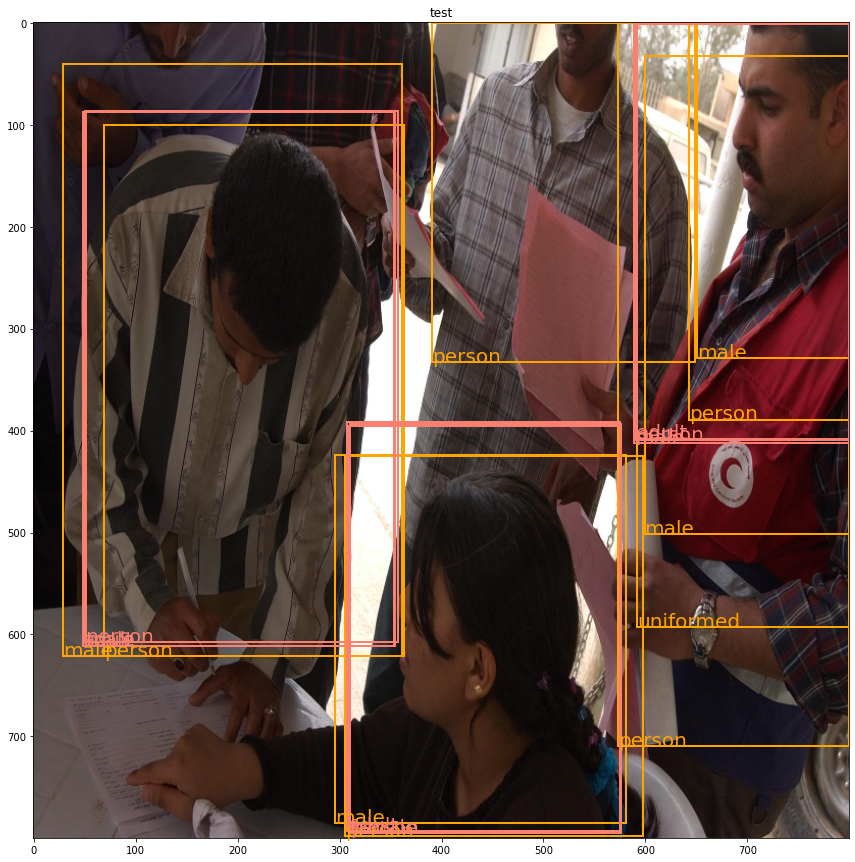

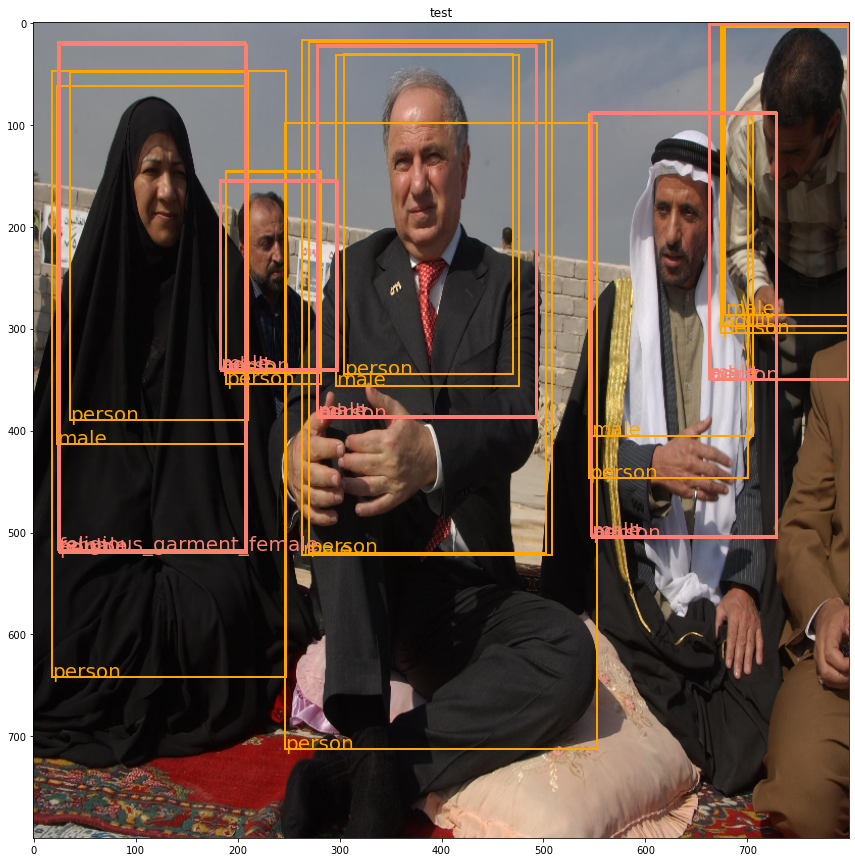

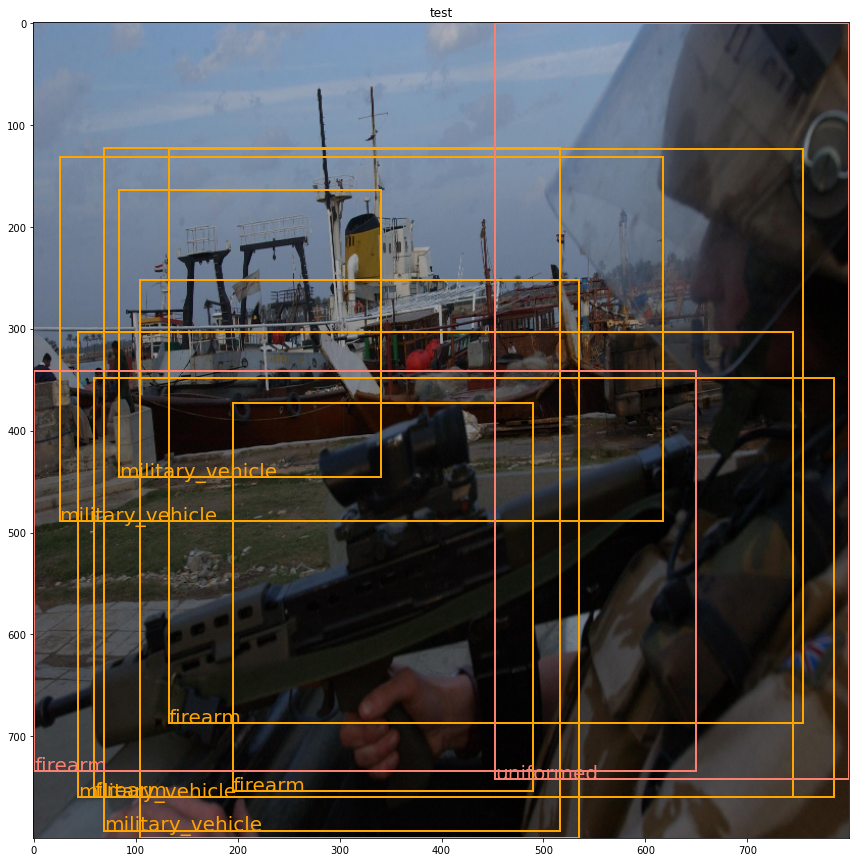

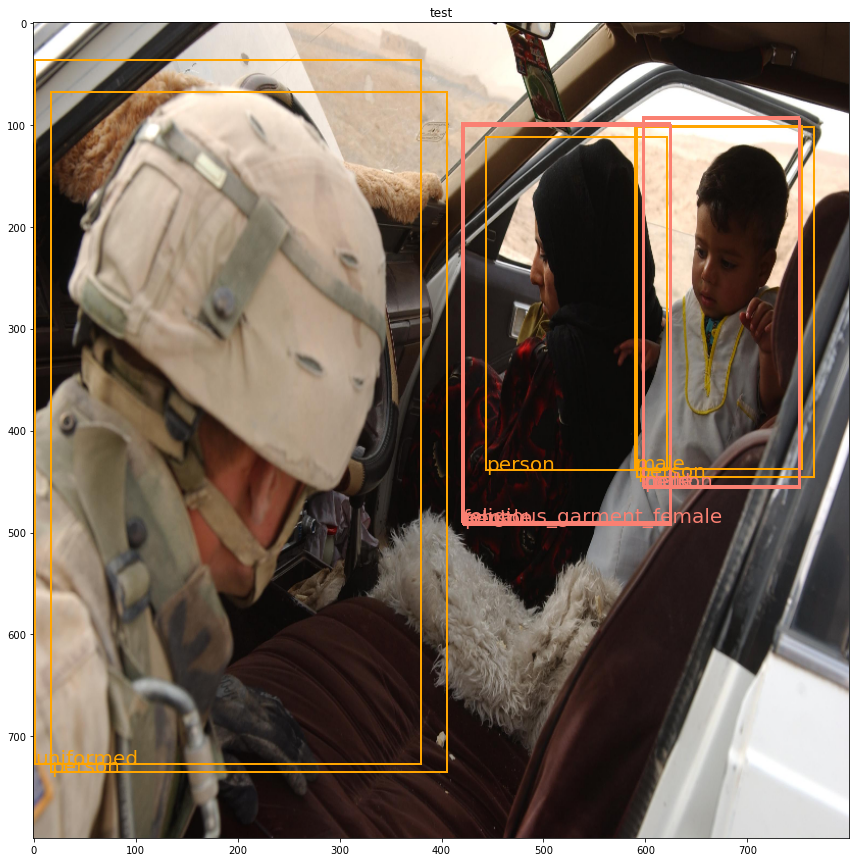

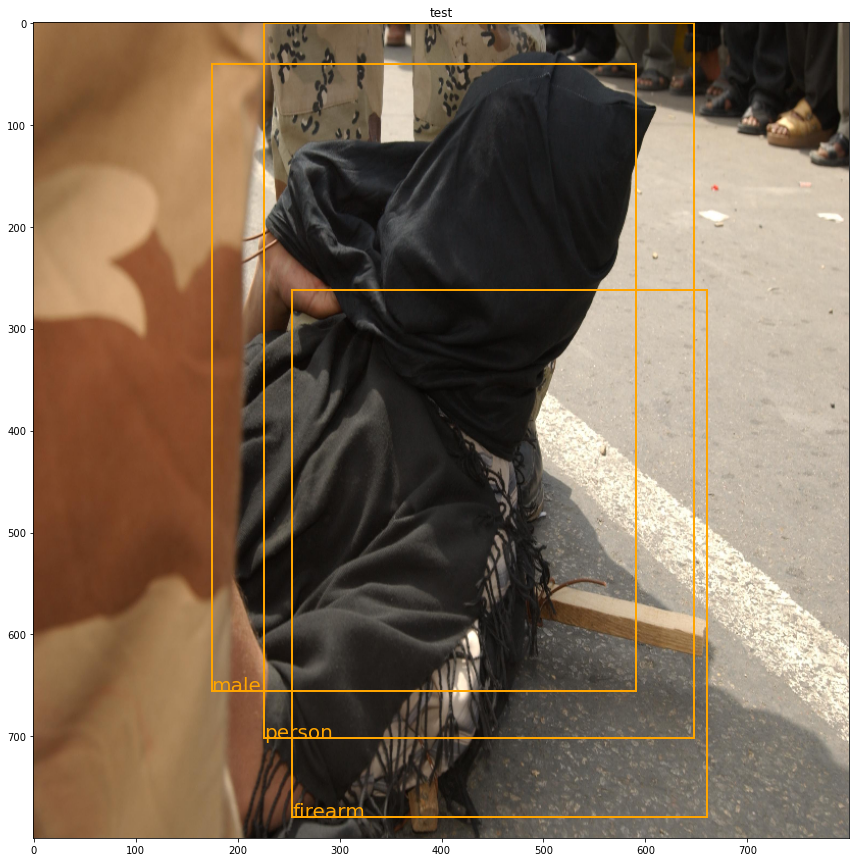

...

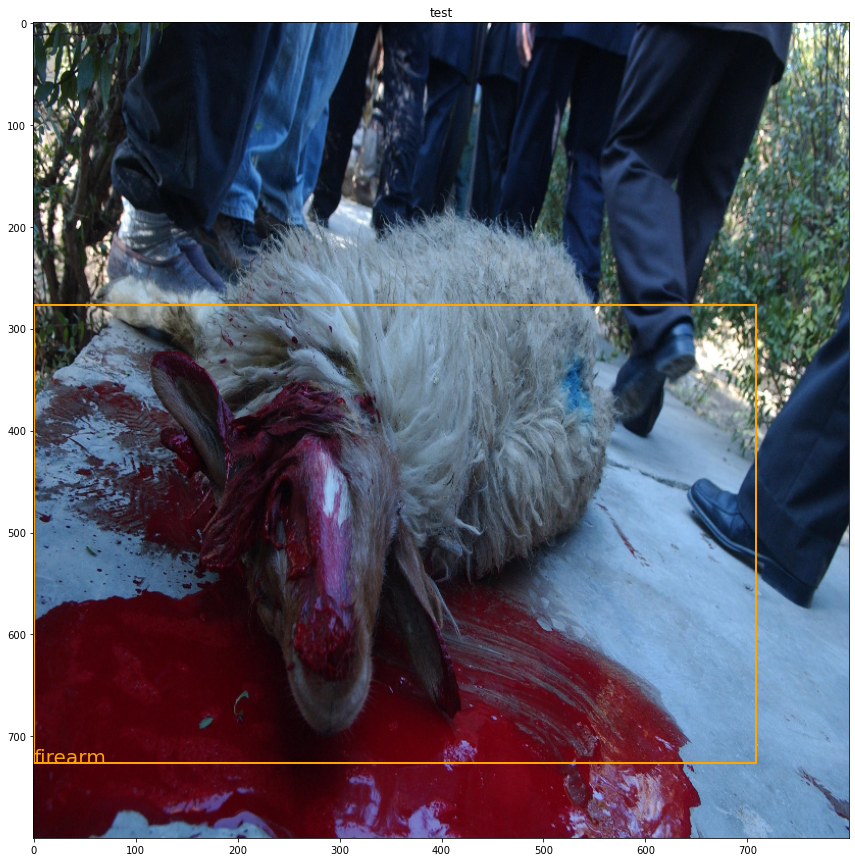

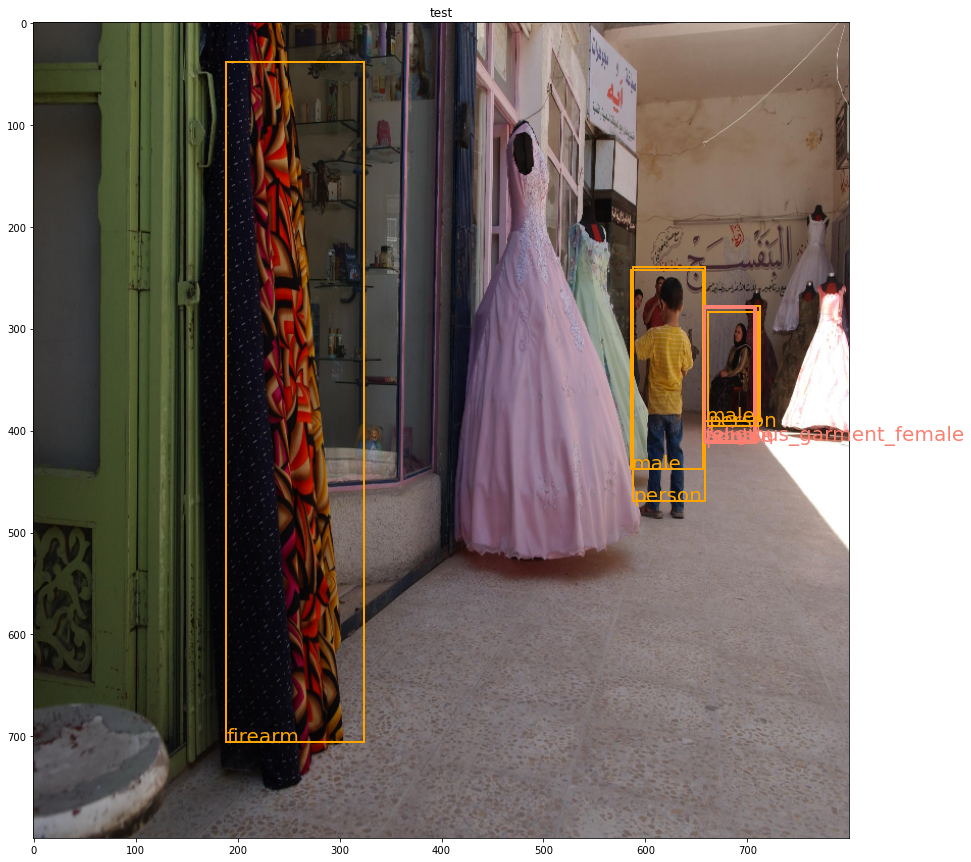

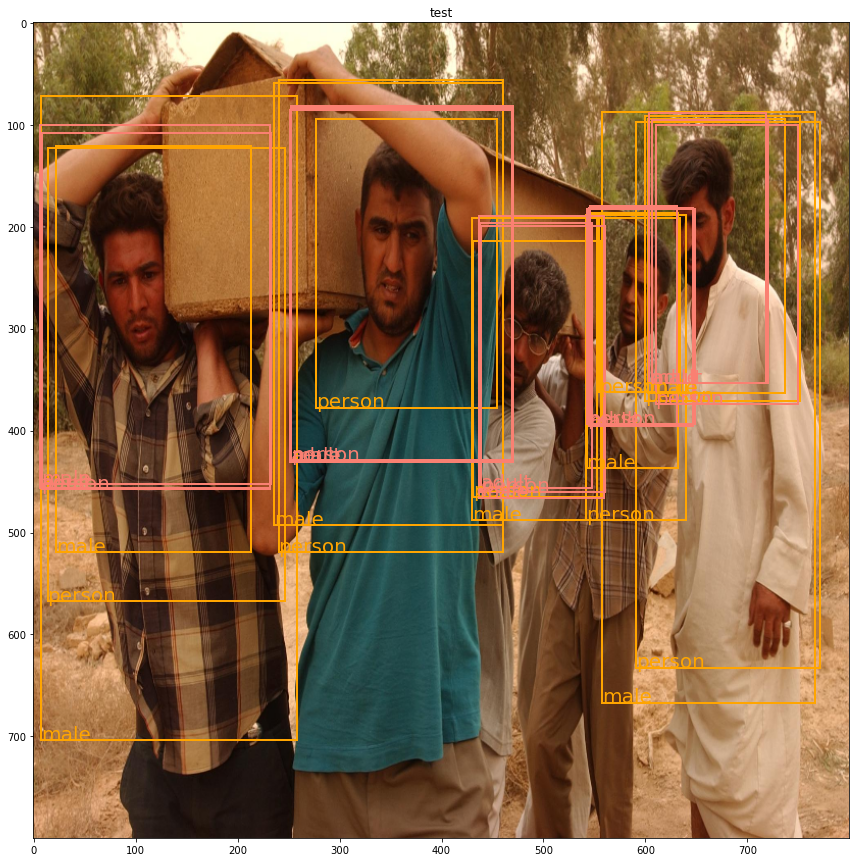

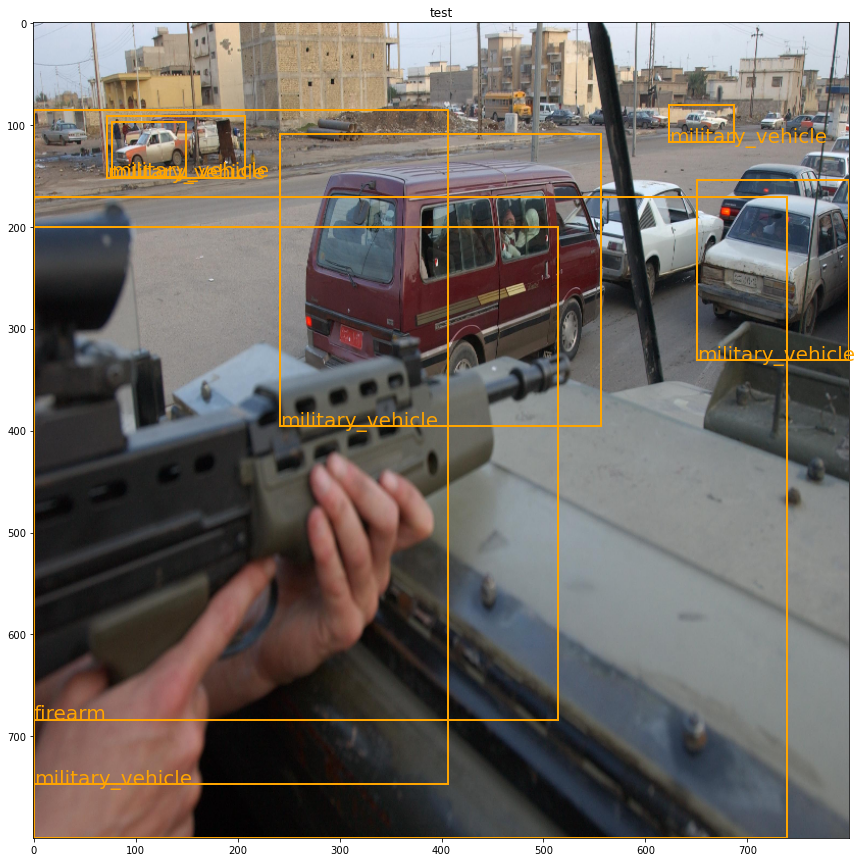

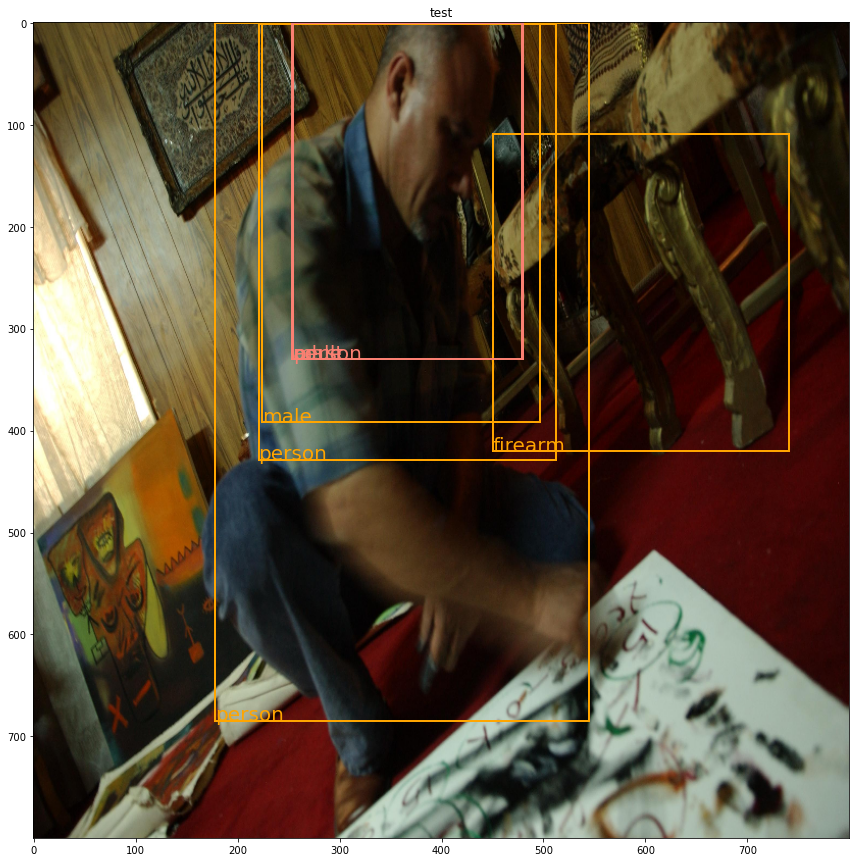

In [7]:
plot_boundry_boxes(dataset, images, targets, predictions, 0.2)

In [8]:
dataset_full = MyDataset(files_dir)
n_image = len(dataset_full)
train_ratio = 0.8
test_ratio = 1 - train_ratio 

1007